## 设置jupyter主题
+ 打开anaconda prompt安装包
```python
pip install jupyterthemes
```
+ 可以看到所有的主题色
```python
jt -l
```
+ 设置主题为onedork
```python
jt -t onedork
```

## RNN Model

In [1]:
import pandas as pd

In [2]:
timeserise_sales = pd.read_csv('time_serise_sale.csv')
timeserise_sales.head()

,Unnamed: 0,week_1,week_2,week_3,week_4,week_5,week_6,week_7,week_8,week_9,...,week_43,week_44,week_45,week_46,week_47,week_48,week_49,week_50,week_51,week_52
0,0,2.291574,2.882838,3.581805,4.013875,1.109924,2.834247,2.625045,2.196884,4.208887,...,1.242250,2.771072,3.778143,3.161634,3.792645,2.015481,2.826184,2.520788,2.637210,2.748923
1,1,0.609664,2.523604,2.609537,3.695997,3.399272,2.616612,1.651935,1.348295,3.862523,...,2.477505,2.284513,3.461783,3.101052,3.442420,1.915776,2.426168,1.662855,2.481925,2.411202
2,2,3.422793,1.812651,-0.097966,1.724064,3.093660,1.781278,2.849946,2.949707,3.560835,...,2.219667,2.359834,1.932029,2.731947,1.836245,1.219933,1.222740,1.720052,2.169939,2.161702
3,3,3.372283,2.577254,3.854308,3.449679,2.517676,2.635679,2.352706,2.856216,1.948434,...,1.670912,0.909113,3.216652,1.775346,3.270484,2.399709,3.032071,1.703666,1.750585,1.821736
4,4,2.997727,1.799415,3.648090,2.391567,2.376778,1.864717,0.408062,2.346726,3.260303,...,2.304058,3.038905,2.038733,2.825186,2.232937,2.509050,2.881796,-1.712131,2.140366,1.926818


In [3]:
timeserise_sales = timeserise_sales.set_index('Unnamed: 0')
timeserise_sales.index.name = None
timeserise_sales.head()

,week_1,week_2,week_3,week_4,week_5,week_6,week_7,week_8,week_9,week_10,...,week_43,week_44,week_45,week_46,week_47,week_48,week_49,week_50,week_51,week_52
0,2.291574,2.882838,3.581805,4.013875,1.109924,2.834247,2.625045,2.196884,4.208887,2.969051,...,1.242250,2.771072,3.778143,3.161634,3.792645,2.015481,2.826184,2.520788,2.637210,2.748923
1,0.609664,2.523604,2.609537,3.695997,3.399272,2.616612,1.651935,1.348295,3.862523,2.061477,...,2.477505,2.284513,3.461783,3.101052,3.442420,1.915776,2.426168,1.662855,2.481925,2.411202
2,3.422793,1.812651,-0.097966,1.724064,3.093660,1.781278,2.849946,2.949707,3.560835,2.813926,...,2.219667,2.359834,1.932029,2.731947,1.836245,1.219933,1.222740,1.720052,2.169939,2.161702
3,3.372283,2.577254,3.854308,3.449679,2.517676,2.635679,2.352706,2.856216,1.948434,1.484706,...,1.670912,0.909113,3.216652,1.775346,3.270484,2.399709,3.032071,1.703666,1.750585,1.821736
4,2.997727,1.799415,3.648090,2.391567,2.376778,1.864717,0.408062,2.346726,3.260303,2.645002,...,2.304058,3.038905,2.038733,2.825186,2.232937,2.509050,2.881796,-1.712131,2.140366,1.926818


In [4]:
import torch

In [5]:
import torch.nn as nn #nn是torch的neural network
import numpy as np

In [11]:
from torch import optim 

In [17]:
import random

In [38]:
import matplotlib.pyplot as plt

In [15]:
# 随机取sample_size个数据
def sample_from_table(sample_size, dataframe):
    sample_row = dataframe.sample().values[0]
    
    begin_column = random.randint(0, len(sample_row) - sample_size - 1) 
    
    choosen_data = sample_row[begin_column:begin_column+sample_size+1]
    
    return (choosen_data[:sample_size], choosen_data[1:])

In [34]:
class RecurrentModel(nn.Module):
    def __init__(self, x_size, hidden_size, n_layers, batch_size, output_size):
        super(RecurrentModel, self).__init__()
        
        self.hidden_size = hidden_size
        self.n_layers = n_layers
        
        self.batch_size = batch_size
        #self.inp = nn.Linear(1, hidden_size) 
        
        # batch_first=True返回结果的时候，假设给的数据是5*10，返回结果是5*10，如果不写返回的可能是10*5
        self.rnn = nn.RNN(x_size, hidden_size, n_layers, batch_first=True)
        
        # 线性变换，把y变成我们期望的结果
        self.out = nn.Linear(hidden_size, output_size) # 10 in and 10 out

    def forward(self, inputs, hidden=None):
        hidden = self.__init__hidden() # 初始化hidden
        #print("Forward hidden {}".format(hidden.shape))
        #print("Forward inps {}".format(inputs.shape))
        output, hidden = self.rnn(inputs.float(), hidden.float())
        #print("Out1 {}".format(output.shape))
        output = self.out(output.float());
        #print("Forward outputs {}".format(output.shape))

        return output, hidden

    def __init__hidden(self):
        hidden = torch.autograd.Variable(torch.zeros(self.n_layers, self.batch_size, self.hidden_size, dtype=torch.double))
        return hidden

In [20]:
torch.from_numpy(np.array([[1,2,3],[2,3,4]]))

tensor([[1, 2, 3],
        [2, 3, 4]])

In [21]:
torch.from_numpy(np.array([[1,2,3],[2,3,4]])).unsqueeze(2)

tensor([[[1],
         [2],
         [3]],

        [[2],
         [3],
         [4]]])

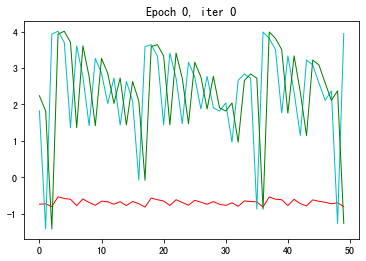

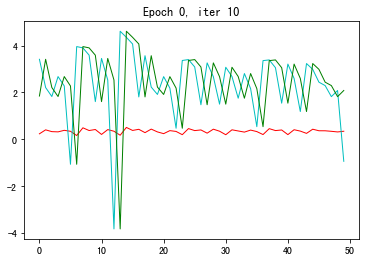

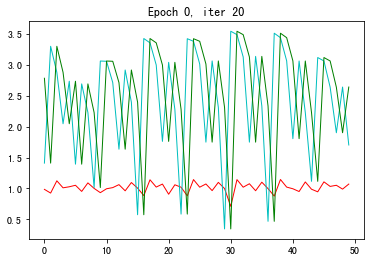

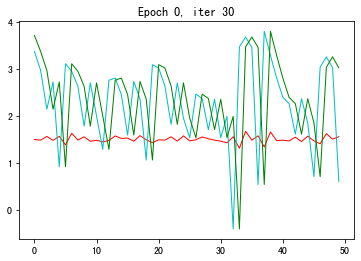

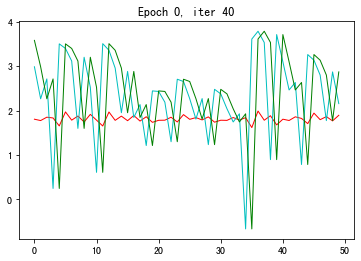

...

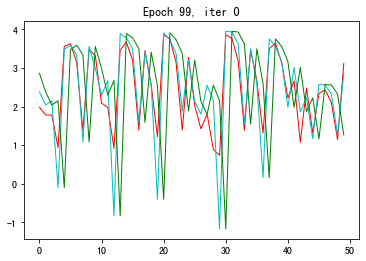

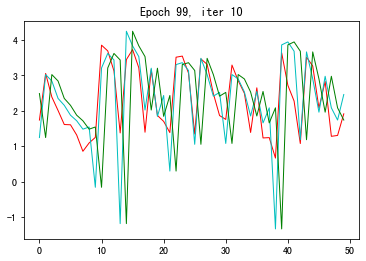

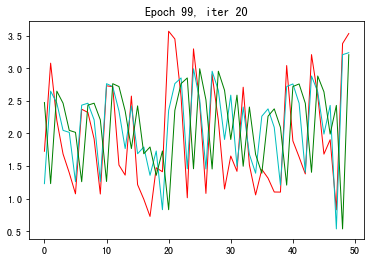

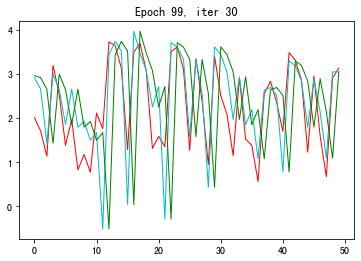

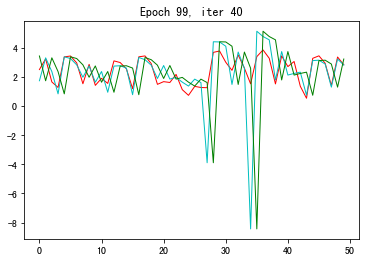

In [39]:
# 虽然一次给10个数据，但是给rnn的时候，每个数据都是t节点的，模型里的x_size是指，对于每个cell y需要的x的size，
# 单纯映射到每一步的话，size是1
x_size = 1 
hidden_size = 3 # same as FullyConnected
n_layers = 2 # rnn的层数
n_sample_size = 50
time_span = 10
output_size = 1 # 5组 [10个[1]维向量]

rnn_model = RecurrentModel(x_size,hidden_size,n_layers,int(n_sample_size / time_span),output_size)
# def __init__(self, x_size, hidden_size, n_layers, batch_size, output_size):
# rnn_model = rnn_model.double()


criterion = nn.MSELoss() # LOSS

# 除了梯度下降，还有很多别的优化方法，此处用的SGD
optimizer = optim.SGD(rnn_model.parameters(),lr=0.01)

n_epochs = 100

n_iters = 50

losses = np.zeros(n_epochs)

# hidden = rnn_model.init__hidden()

for epoch in range(n_epochs):
    for iter_ in range(n_iters):
        inputs_,targets_ = sample_from_table(50, timeserise_sales)

        inputs = torch.from_numpy(np.array([
                        inputs_[0:10], 
                        inputs_[10:20], 
                        inputs_[20:30], 
                        inputs_[30:40], 
                        inputs_[40:50]], dtype=np.double)).unsqueeze(2).float() # 输入

        targets = torch.from_numpy(np.array([
                        targets_[0:10], 
                        targets_[10:20], 
                        targets_[20:30], 
                        targets_[30:40], 
                        targets_[40:50]], dtype=np.double)).unsqueeze(2).float() # 输出

        outputs,hidden = rnn_model(inputs.double(),None) # yhat

        loss = criterion(outputs,targets) # loss

        optimizer.zero_grad() 

        loss.backward() # 反向传播

        optimizer.step() # 更新权值

        losses[epoch] += loss

        if iter_ % 10 == 0:
            plt.clf()
            plt.ion()

            plt.title("Epoch {}, iter {}".format(epoch, iter_))

            plt.plot(torch.flatten(outputs.detach()),'r-',linewidth=1,label='Output') # 预测数据 - 红色
            plt.plot(torch.flatten(targets),'c-',linewidth=1,label='Label') # 真实数据 - 浅蓝
            plt.plot(torch.flatten(inputs),'g-',linewidth=1,label='Input') # 输入数据 - 绿色

            plt.draw();
            plt.pause(0.05);

#### 对比两层的全连接模型，两层的knn拟合的效果更好 

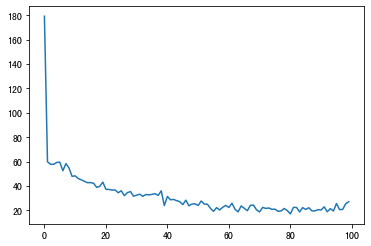

In [40]:
plt.plot(losses)

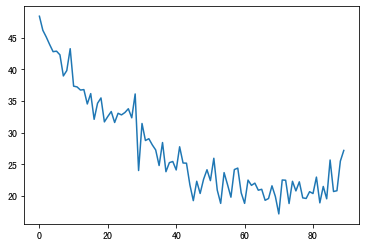

In [43]:
plt.plot(losses[10:])

In [44]:
rnn_model.state_dict()

OrderedDict([('rnn.weight_ih_l0',
              tensor([[ 1.2302],
                      [ 0.6044],
                      [-1.5019]])),
             ('rnn.weight_hh_l0',
              tensor([[-0.4450, -0.0557, -0.3753],
                      [ 0.1547,  0.5686, -0.6189],
                      [ 0.5797,  1.1504, -0.4422]])),
             ('rnn.bias_ih_l0', tensor([-0.2516, -0.7376,  0.2360])),
             ('rnn.bias_hh_l0', tensor([-0.7938, -1.0591,  1.2706])),
             ('rnn.weight_ih_l1',
              tensor([[ 0.4739, -0.7396, -0.9956],
                      [ 0.9405,  0.9312, -0.7492],
                      [ 0.3458,  0.1422, -0.5709]])),
             ('rnn.weight_hh_l1',
              tensor([[ 0.4068,  0.3717,  0.9840],
                      [ 0.1823, -0.2683,  0.2463],
                      [-0.4869,  1.0237, -0.1703]])),
             ('rnn.bias_ih_l1', tensor([-0.7904, -0.0426, -0.2038])),
             ('rnn.bias_hh_l1', tensor([-0.8232,  0.0507, -0.4653])),
             (

## Stacked RNN 
+ 也是上边讲的
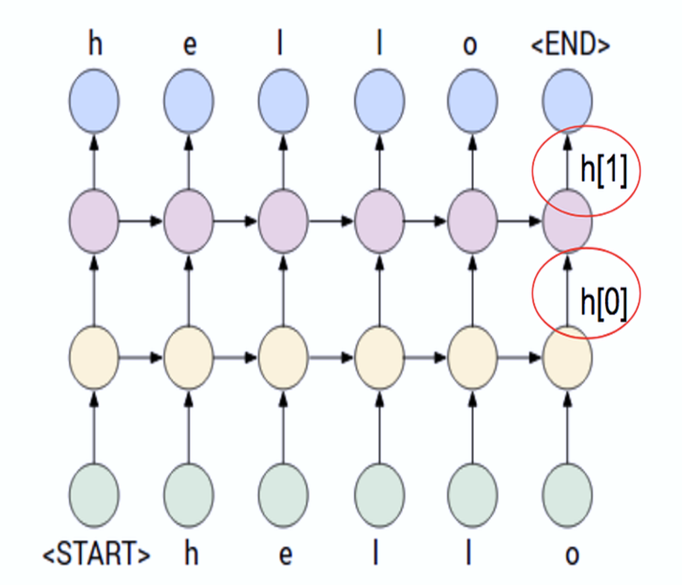

## Bidirectional RNN 双向RNN 
+ 比如文本翻译，不仅和前边的文本有关系，也和后边的文本有关系
+ Elman network可变为:
$$ℎ_𝑡=𝜎_ℎ (𝑊_ℎ 𝑥_𝑡+𝑈_ℎ ℎ_{𝑡−1}+𝑈_ℎ ℎ_{𝑡+1}+𝑏_ℎ )$$
$$𝑦_𝑡=𝜎_𝑦 (𝑊_𝑦 ℎ_𝑡+𝑏_𝑦)$$

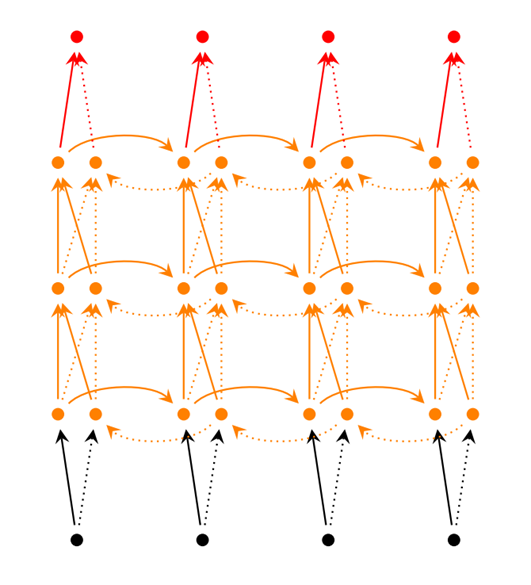

## RNN存在问题：梯度消失(Vanishing)与梯度爆炸(Exploding)
+ Deep Learing 与Neural Network区别：1，大于三层的神经网络是深度学习；2，由于Deep，会产生Vanishing与Exploding的问题
+ 其他DeepLearing也会有这个问题，但是RNN由于自身的结构问题，尤为典型
+ 梯度连乘，可能会产生梯度非常小或者非常大的情况
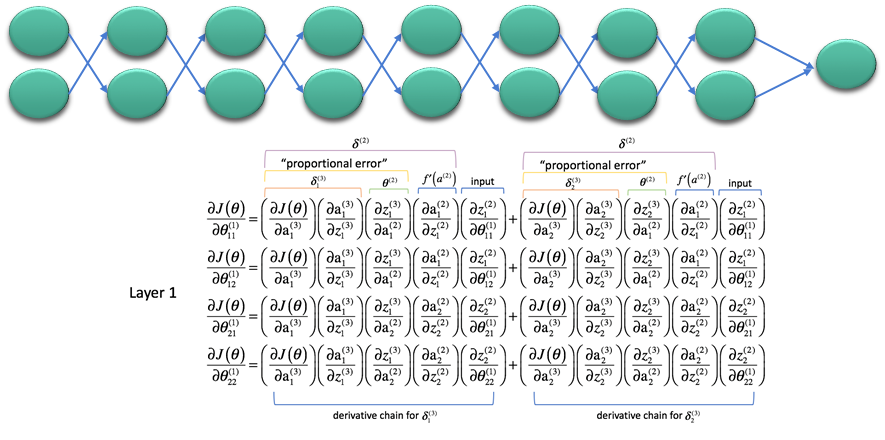

#### 解决梯度消失问题 -- Batch normalization ，BN结（标准化，正规化）
+ Batch Normalization allows us to use much higher learning rates and be less careful about initialization. 
+ 梯度消失产生的原因可能是x太小了，导致loss在求偏导后也很小，对x,y做标准化可以重新放大x的大小
+ BN结作用：防止模型比较深的时候，梯度消失
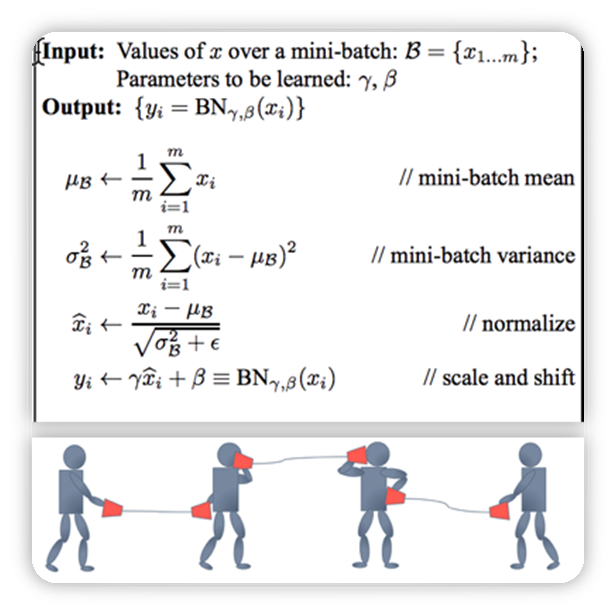

#### 解决梯度爆炸问题 Gradient clipping
+ 直接将过大的梯度值变小
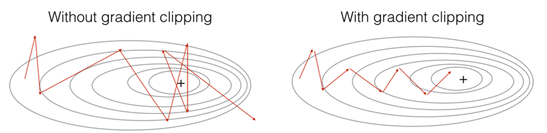

+ 直接将梯度大于100的变成100
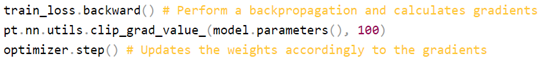

## LSTM 长短记忆模型
+ L-Long S-Short T-Term M-Memory
+ Gate: Information Control 
+ 更高级的RNN模型，也是RNN家族的，性能更好

#### 普通RNN
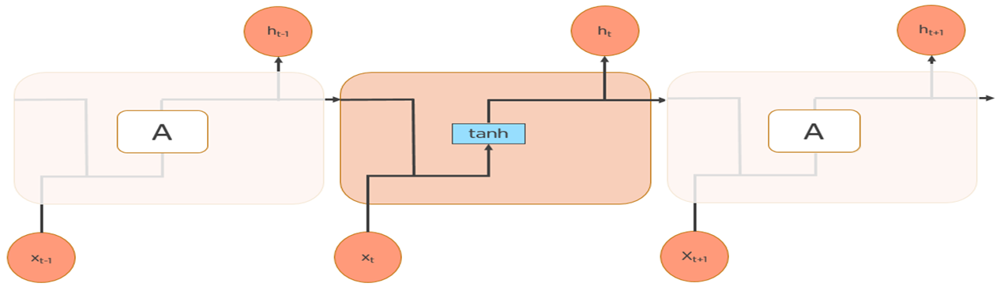

#### LSTM
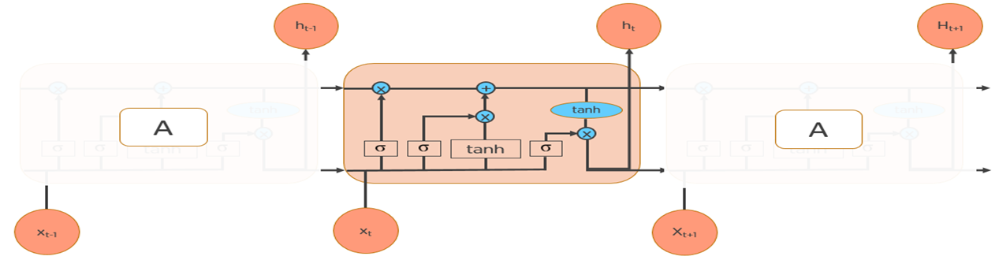

### LSTM原理

+ step-01:Decide how much past data it should remember

> $𝑓_𝑡=𝜎(𝑊_𝑓⋅[ℎ_{𝑡−1}, 𝑥_𝑡 ]+𝑏_𝑓 )-->[0,1]$

$f_t$遗忘门，经过$\sigma,f_t区间为[0,1]$

+ Step-02:Decide how much this unit adds to the current state 

> $𝑖_𝑡=𝜎(𝑊_𝑡⋅[ℎ_{𝑡−1}, 𝑥_𝑡 ]+𝑏_𝑖 )-->[0,1]$

> $𝐶_𝑡  ̃=tanh⁡(𝑊_𝑐⋅[ℎ_{𝑡−1}, 𝑥_𝑡 )+𝑏_𝑐  ])-->[-1,1]$

$i_t$输入门，经过$\sigma,i_t区间为[0,1]$

$𝐶_𝑡  ̃$,经过$tanh区间为[-1,1]$

+ Step-03:Decide what part of the current cell state makes it to the output

> $𝐶_𝑡=𝑓_𝑡  ∗𝐶_{𝑡−1}+𝑖_𝑡  ∗(𝐶_𝑡 ) ̃$

> $O_𝑡=𝜎(𝑊_𝑜 [ℎ_{𝑡−1}, 𝑥_𝑡 ]+𝑏_𝑜 )-->[0,1]$

> $ℎ_𝑡=𝑂_𝑡  ∗tanh⁡(𝐶_𝑡 )-->[-1,1]$

$𝐶_𝑡$中，$f_t$决定上一状态遗留多少信息，因此叫遗忘门，$i_t$决定当前输入保留多少信息，因此叫输入门

$O_t$输出门，经过$\sigma,O_t区间为[0,1]$ ，$tanh⁡(𝐶_𝑡 )$输出数据区间为[-1,1]



#### 保留信息多少，用$\sigma$,输出[0,1];
#### 影响大小，用tanh,输出[-1,1]


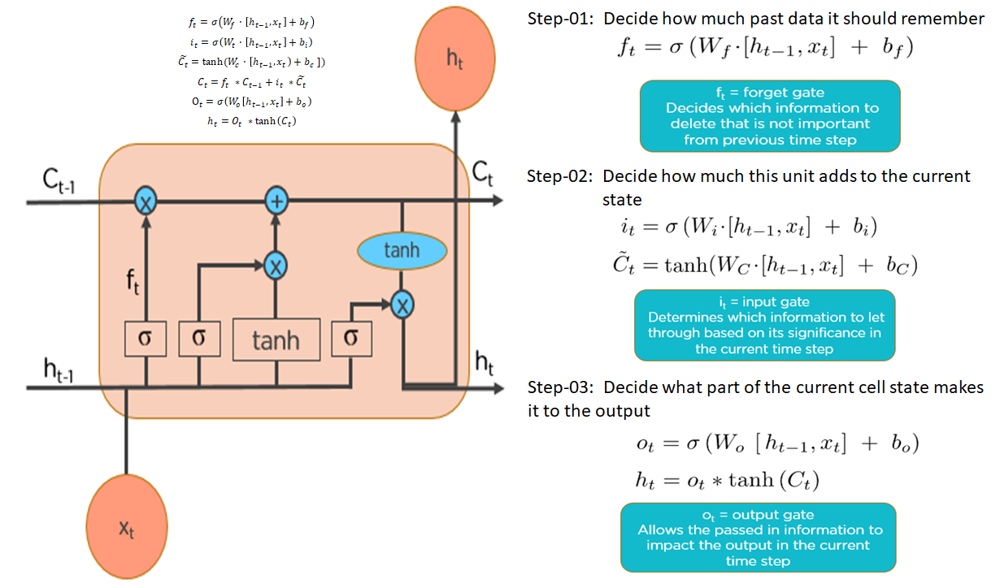

### LSTM为什么有效?
+ 当时提出，是按照倒叙的方法，为了解决问题而提出来的
+ 解释1:选择性过滤信息

> LSTM在长短记忆的过程中，$f_t,i_t,o_t$让一些信息保留，一些信息不保留，它有选择性的保留了信息，有选择的记忆，因此有效

+ 解释2:

> 由于$𝐶_𝑡=𝑓_𝑡  ∗𝐶_{𝑡−1}+𝑖_𝑡  ∗(𝐶_𝑡 ) ̃$,则$\frac{\partial{𝐶_𝑡}}{\partial{𝐶_{𝑡−1}}} = 𝑓_𝑡$

> 假如$𝐶_{𝑡−1}对𝐶_𝑡$的影响是大的，可以通过拟合$W_f$，使得$𝑓_𝑡$接近于1，$𝑓_𝑡$接近于1，$\frac{\partial{𝐶_𝑡}}{\partial{𝐶_{𝑡−1}}}$更新会更快一些，符合$𝐶_{𝑡−1}对𝐶_𝑡$的影响大的假设

> 假如$𝐶_{𝑡−1}对𝐶_𝑡$的影响是小的，可以通过拟合$W_f$，使得$𝑓_𝑡$接近于0，$𝑓_𝑡$接近于0，$\frac{\partial{𝐶_𝑡}}{\partial{𝐶_{𝑡−1}}}$更新会更慢一些，符合$𝐶_{𝑡−1}对𝐶_𝑡$的影响小的假设


## 新的LSTM
+ 增加了更多的信息，可以看到以前更多的信息
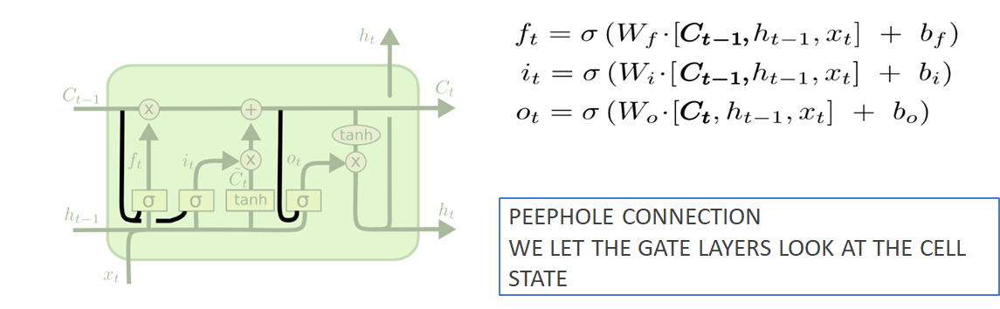

## RNN改进版
+ 在原来的LSTM中，遗忘门$f_t$越大，$C_{t-1}$越大，对过去的数据拿的越多，输入门$i_t$越大，$𝐶_𝑡  ̃$越大，对此时的数据拿的越多，二者呈现一定的负相关关系，因此可做如下简化
+ 下图中$z_t$可以看做$f_t$或者$i_t$
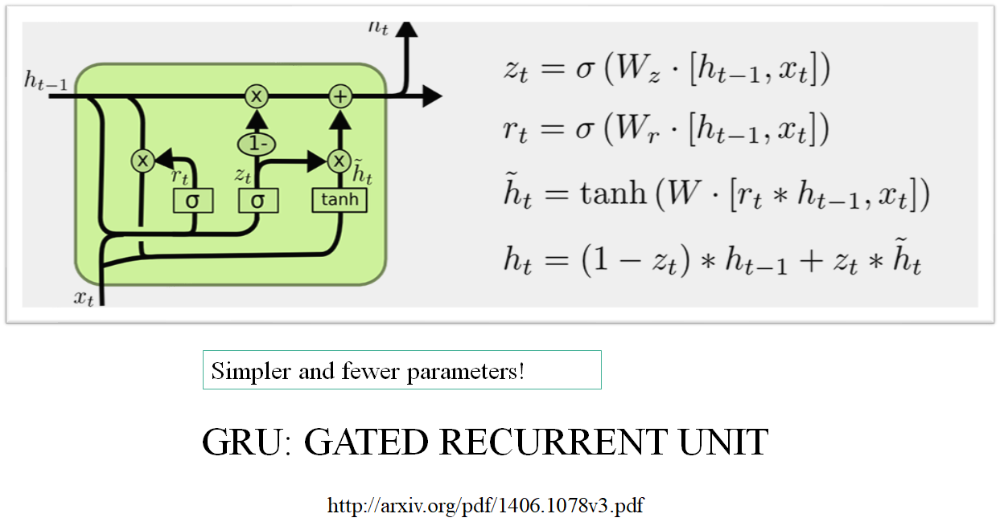

### 模型参数变小，会怎么样呢？
> 参数变小，需要的数据会表少，同样数据情况下，拟合变快，拟合快，下降快，数据少，模型更简单，过拟合可能性变低

## RNN模型的应用 RNN applications
+ Prediction Problems 预测问题
+ Language Modelling and Generating Text 语言模型（给定一段话，其正常的概率），生成文本（one to many）
+ Machine Translation 机器翻译
+ Speech Recognition 语言识别
+ Generating Image Descriptions 生成图像文本描述
+ Video Tagging 图像打标
+ Text Summarization 生成短文本
+ Call Center Analysis 客服中心分析
+ Music composition 自动编曲